In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Ảnh 1

In [24]:
def find(image, template, scale_min=0.5, scale_max=1.0, scale_steps=50):
    # Convert the original image to grayscale
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    template_gray = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)

    # Create a binary mask for the template to highlight non-background areas
    _, mask = cv2.threshold(template_gray, 240, 255, cv2.THRESH_BINARY_INV)

    # Initialize variables to store the best match
    best_scale = None
    best_min_val = float('inf')  # Initialize with a very large number
    best_top_left = None
    best_template_w, best_template_h = None, None

    # Loop over different scales
    scale_factors = np.linspace(scale_min, scale_max, scale_steps)  # Scale factors from scale_min to scale_max
    for scale_factor in scale_factors:
        # Resize the template and mask based on the current scale factor
        new_width = int(template.shape[1] * scale_factor)
        new_height = int(template.shape[0] * scale_factor)
        
        resized_template = cv2.resize(template_gray, (new_width, new_height), interpolation=cv2.INTER_AREA)
        resized_mask = cv2.resize(mask, (new_width, new_height), interpolation=cv2.INTER_AREA)
        result = cv2.matchTemplate(image_gray, resized_template, cv2.TM_SQDIFF_NORMED, mask=resized_mask)
                
        # Find the best match position (minimum value for SQDIFF_NORMED)
        min_val, _, min_loc, _ = cv2.minMaxLoc(result)
        
        # Update the best match if the current match is better
        if min_val < best_min_val:
            best_min_val = min_val
            best_scale = scale_factor
            best_top_left = min_loc
            best_template_w, best_template_h = resized_template.shape[:2]

    # Draw the rectangle around the best match on the original image
    if best_top_left is not None:
        top_left = best_top_left
        bottom_right = (top_left[0] + best_template_h, top_left[1] + best_template_w)
        image_copy = image.copy()
        cv2.rectangle(image_copy, top_left, bottom_right, (0, 255, 0), 2)

        # Convert BGR to RGB for displaying with matplotlib
        image_copy_rgb = cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB)

        # Display the image with the best match
        plt.figure(figsize=(10, 10))
        plt.imshow(image_copy_rgb)
        plt.title(f"Best Matched Template\nBest scale factor: {best_scale:.2f}\nBest matching value: {best_min_val:.4f}")
        plt.axis('off')  # Hide axis
        plt.show()

Processing: 1_objects\ball.jpg


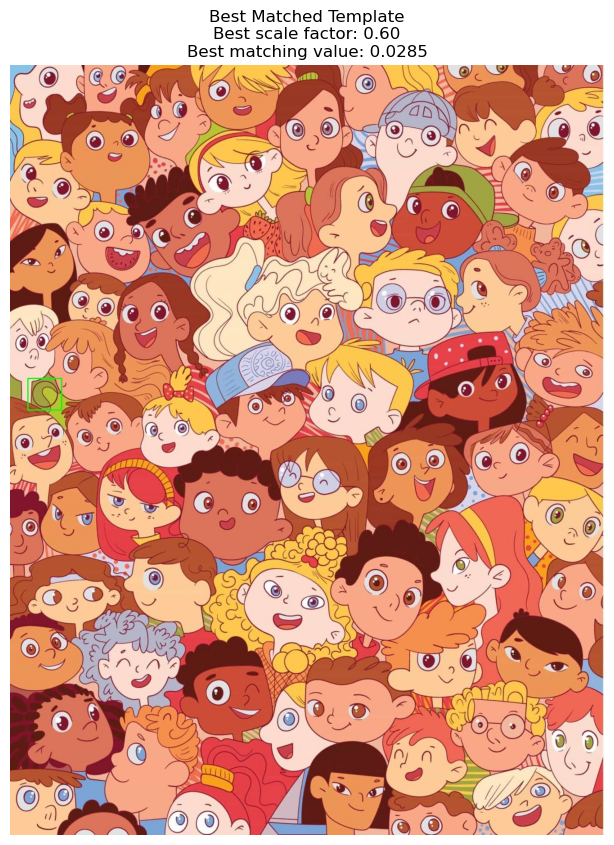

Processing: 1_objects\baloon.jpg


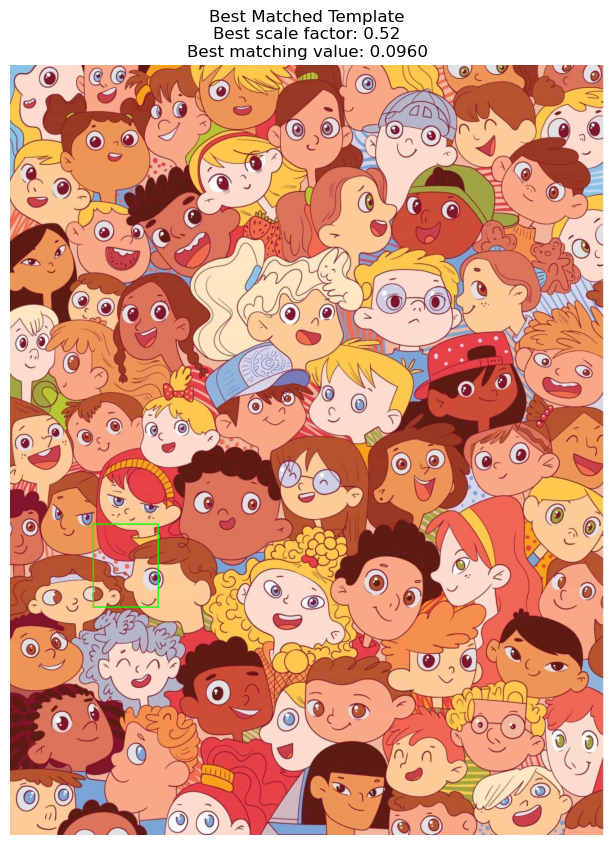

Processing: 1_objects\bear.jpg


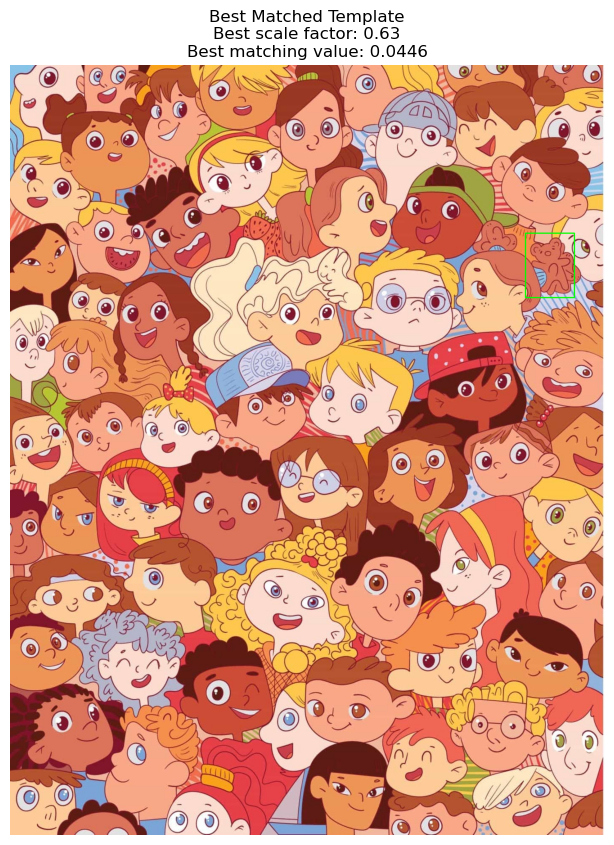

Processing: 1_objects\boat.jpg


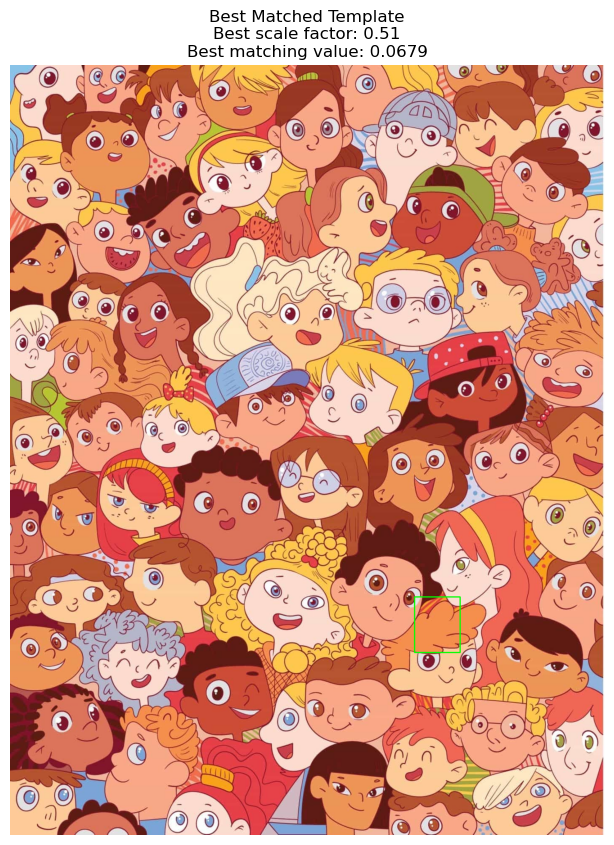

Processing: 1_objects\bow.jpg


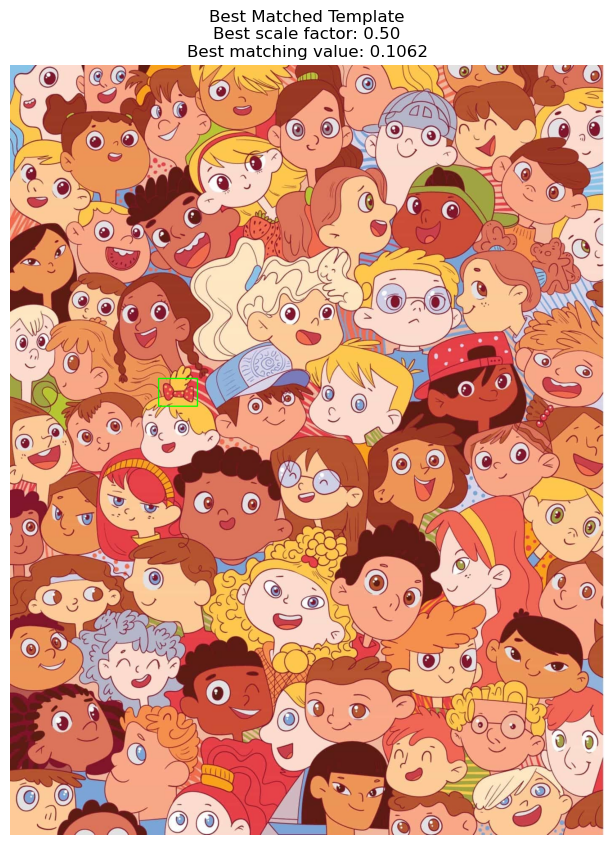

Processing: 1_objects\bunny.jpg


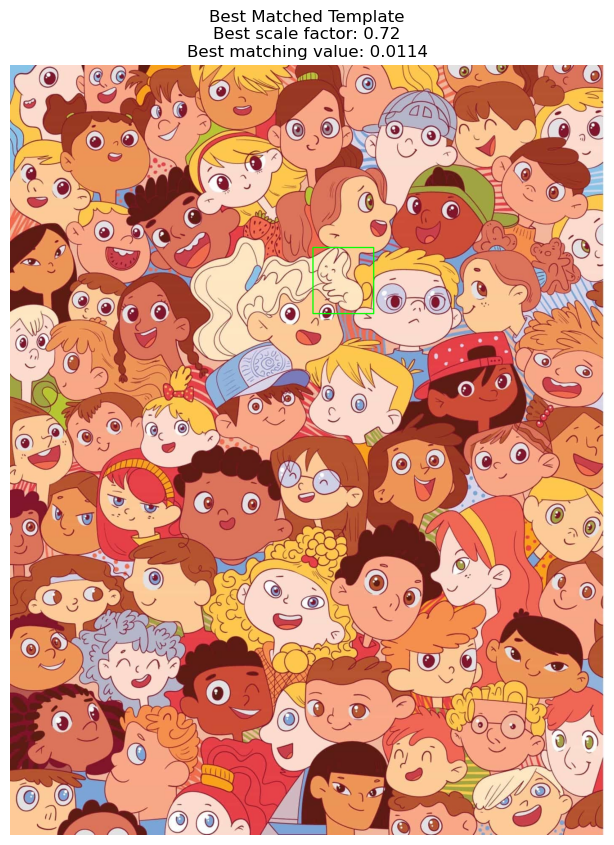

Processing: 1_objects\cake.jpg


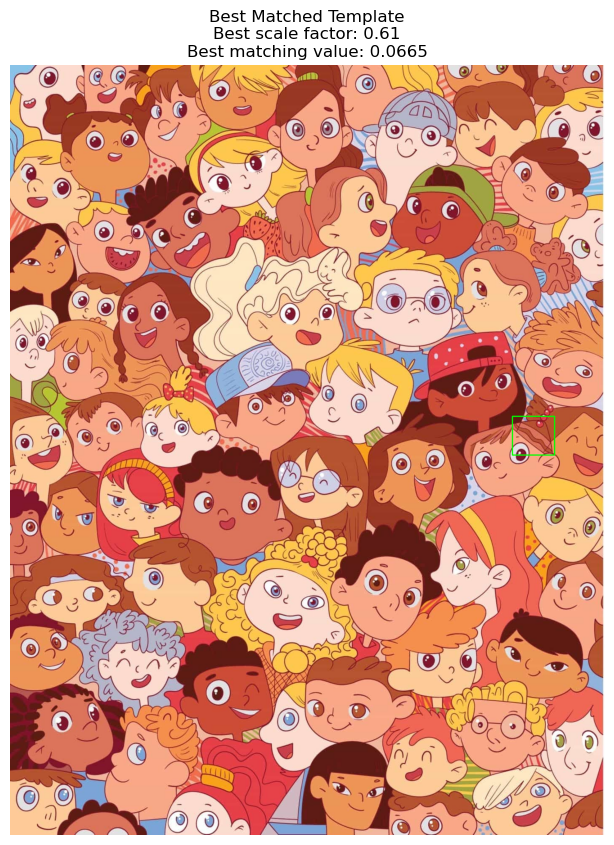

Processing: 1_objects\car.jpg


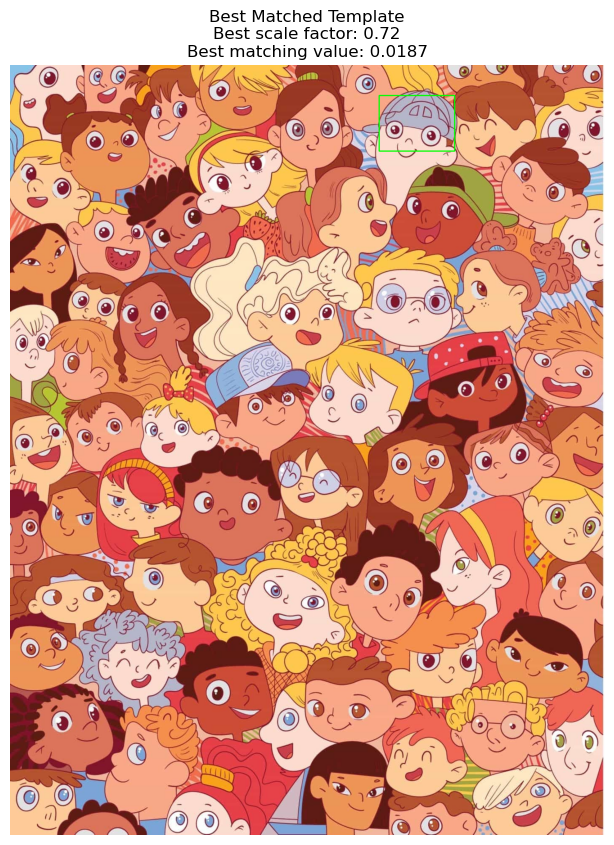

Processing: 1_objects\duck.jpg


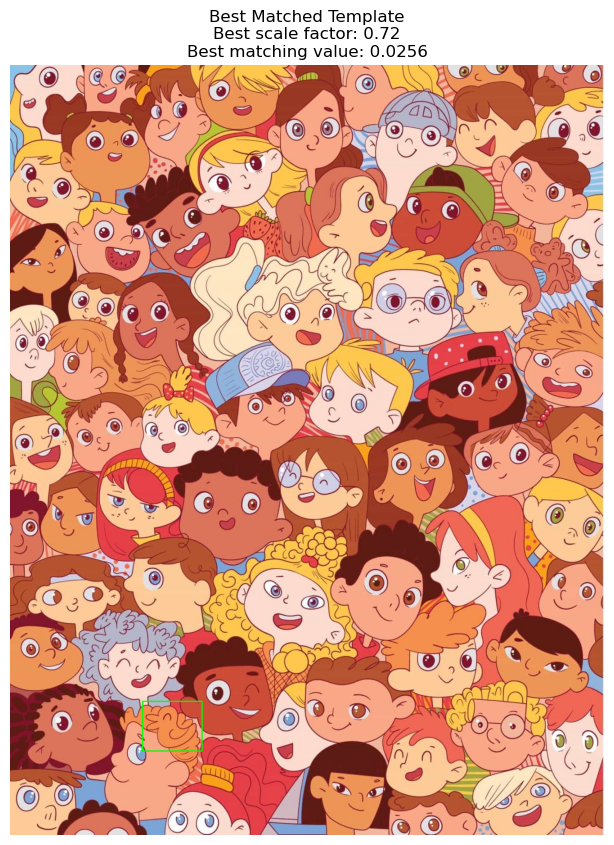

Processing: 1_objects\grape.jpg


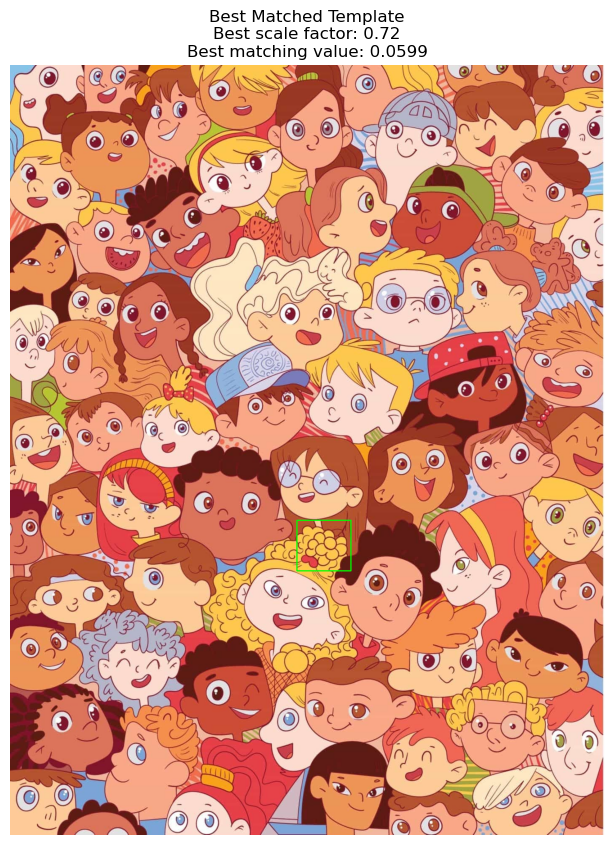

Processing: 1_objects\horse.jpg


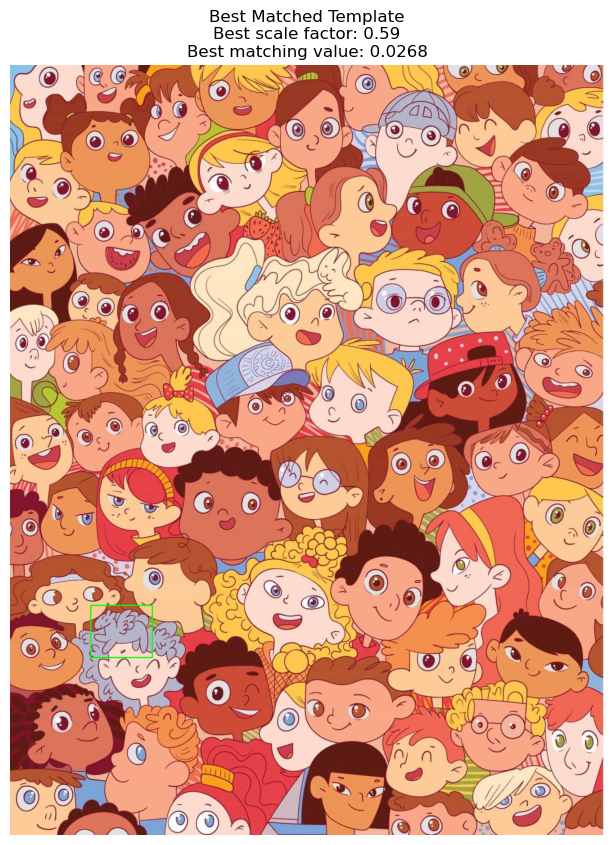

Processing: 1_objects\icecream.jpg


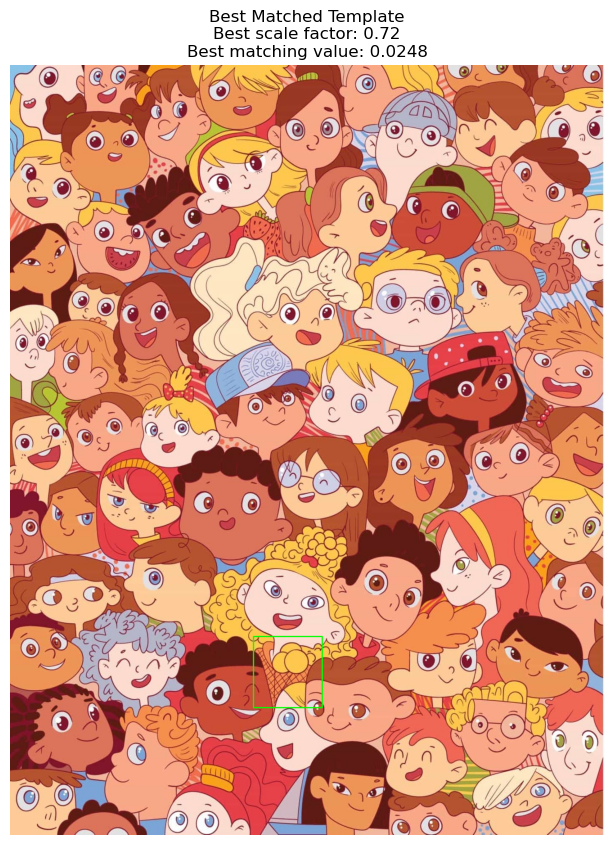

Processing: 1_objects\strawberry.jpg


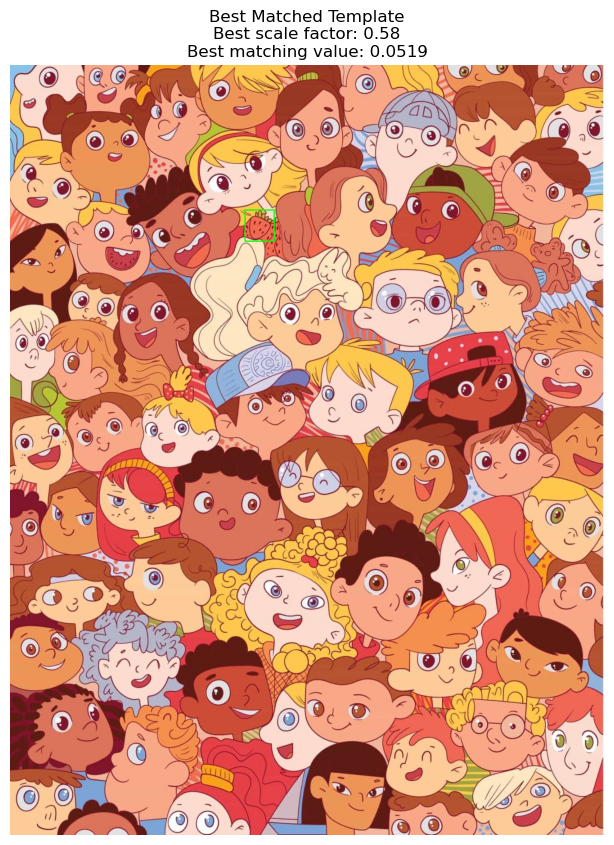

Processing: 1_objects\watermelon.jpg


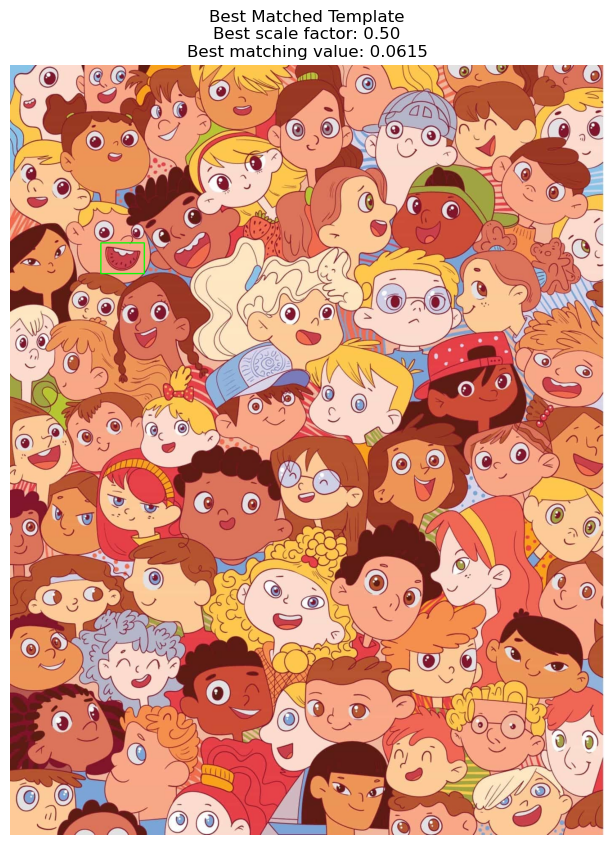

Processing: 1_objects\wood.jpg


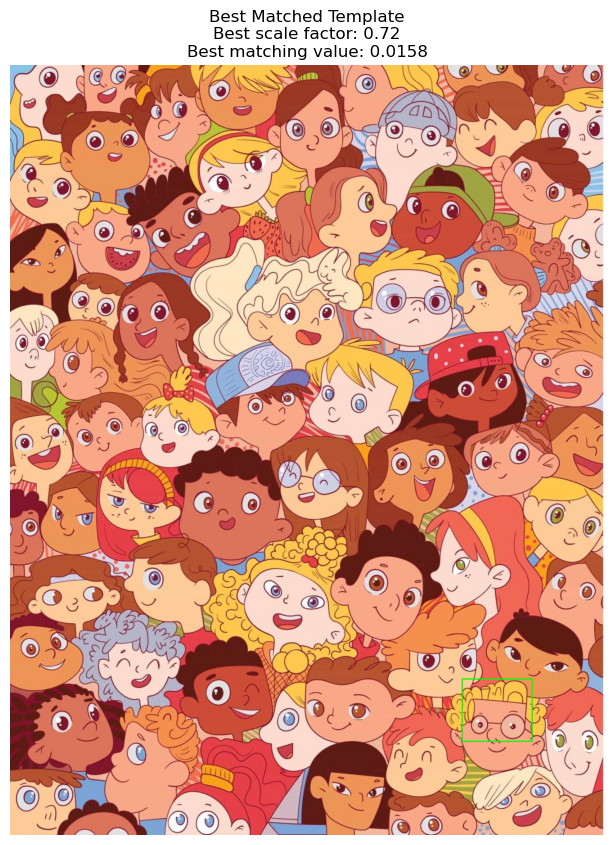

In [25]:

image=cv2.imread("1_cropped.jpg")
# Specify the folder path containing the images
folder_path = "1_objects"  # Replace with your folder path

# List all files in the folder
object_files = [f for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
# Loop through the image files
for object_file in object_files:
    # Get the full path of the image file
    template_path = os.path.join(folder_path, object_file)
    print("Processing:", template_path)
    # Read the image
    template = cv2.imread(template_path)
    
    find(image,template)
    



# Ảnh 2

Processing: 2_objects\ball.jpg


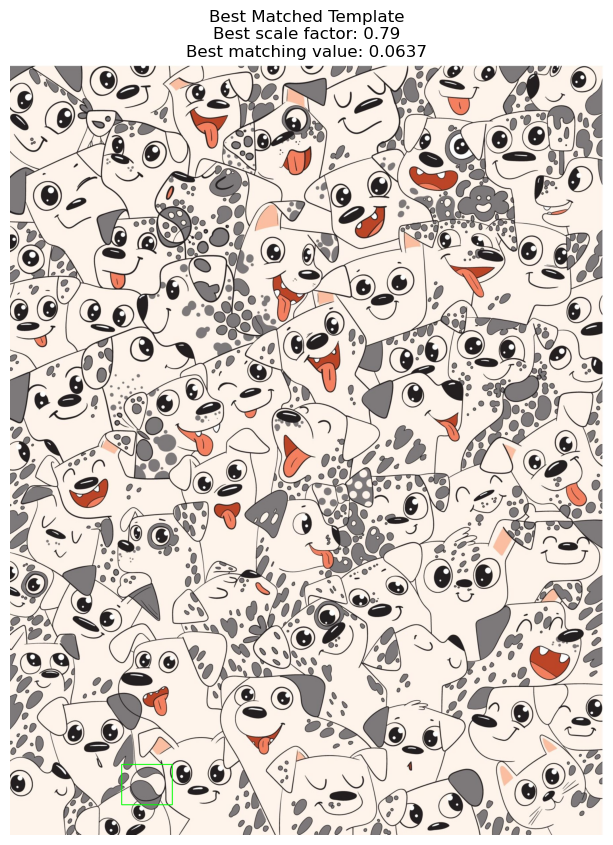

Processing: 2_objects\bone.jpg


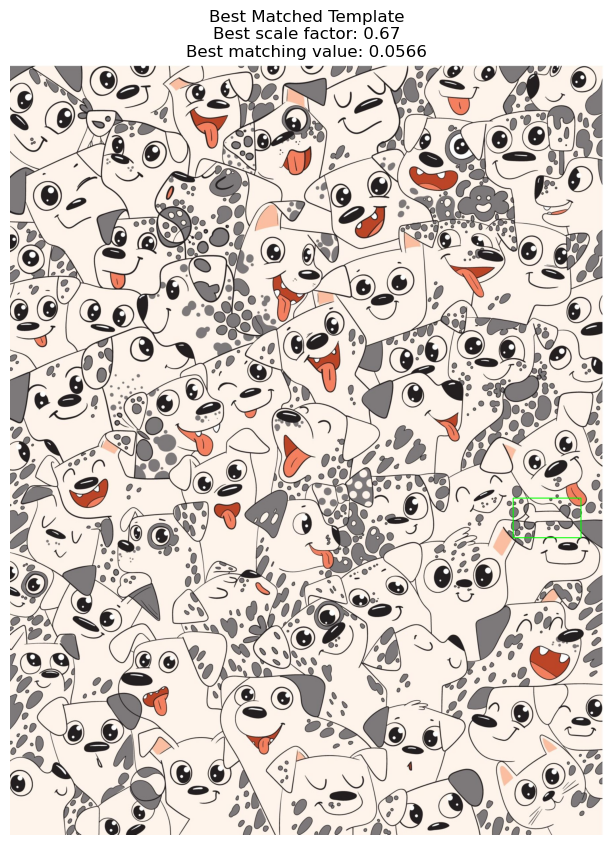

Processing: 2_objects\bow.jpg


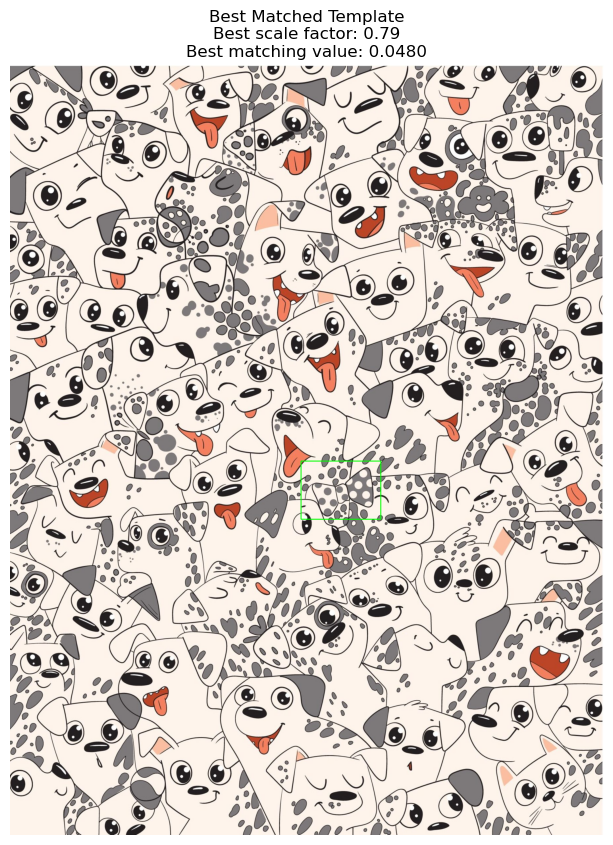

Processing: 2_objects\bug.jpg


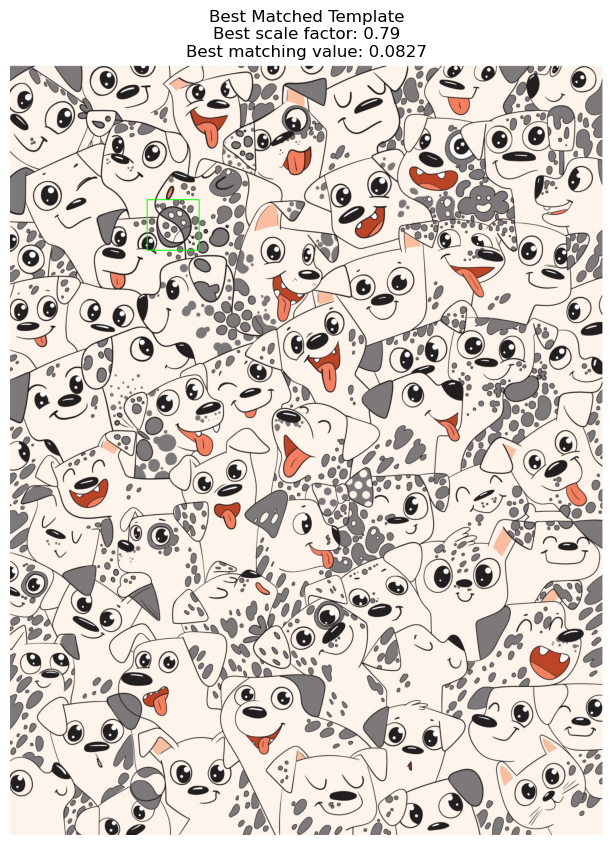

Processing: 2_objects\butterfly.jpg


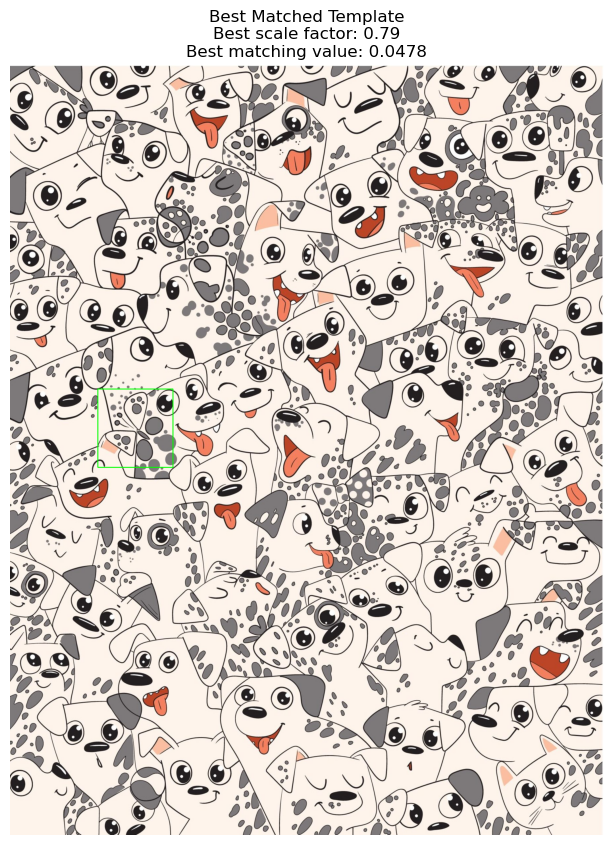

Processing: 2_objects\cheese.jpg


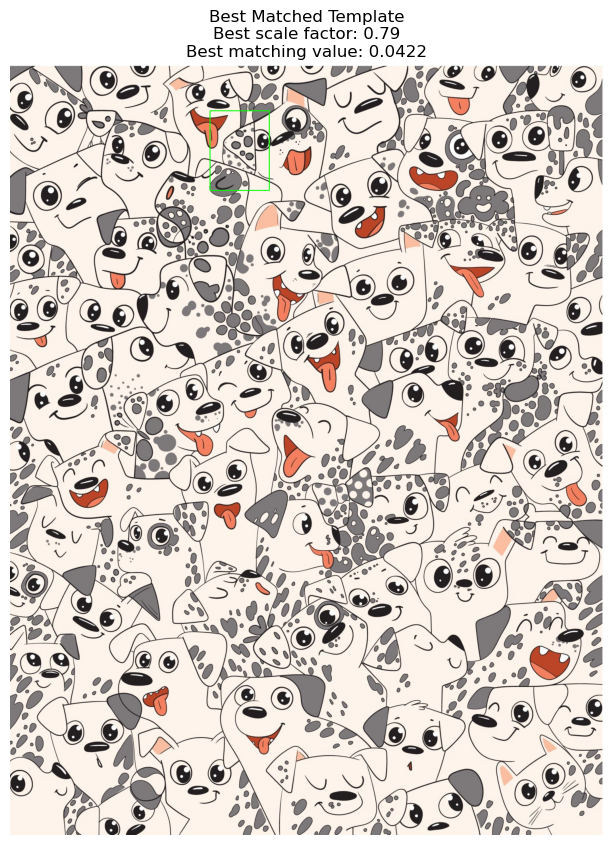

Processing: 2_objects\chicken.jpg


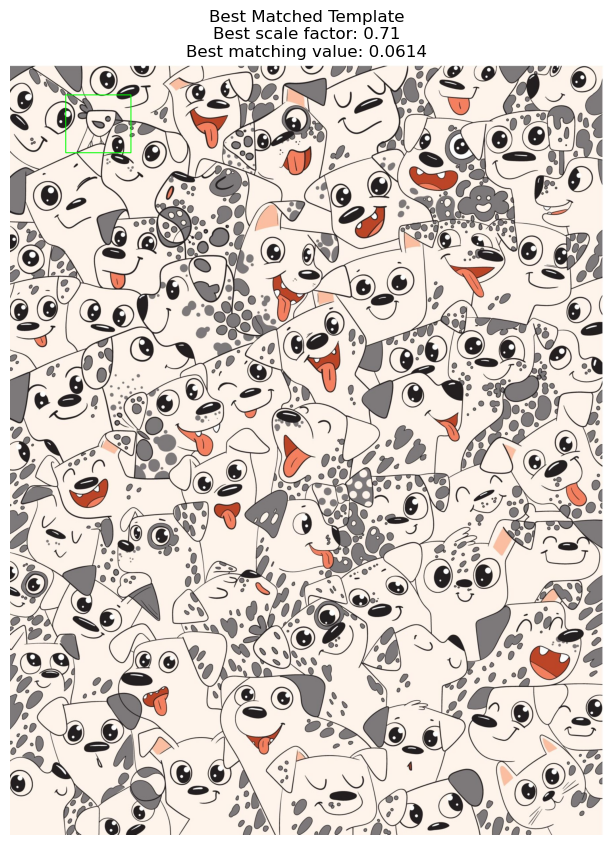

Processing: 2_objects\cloud.jpg


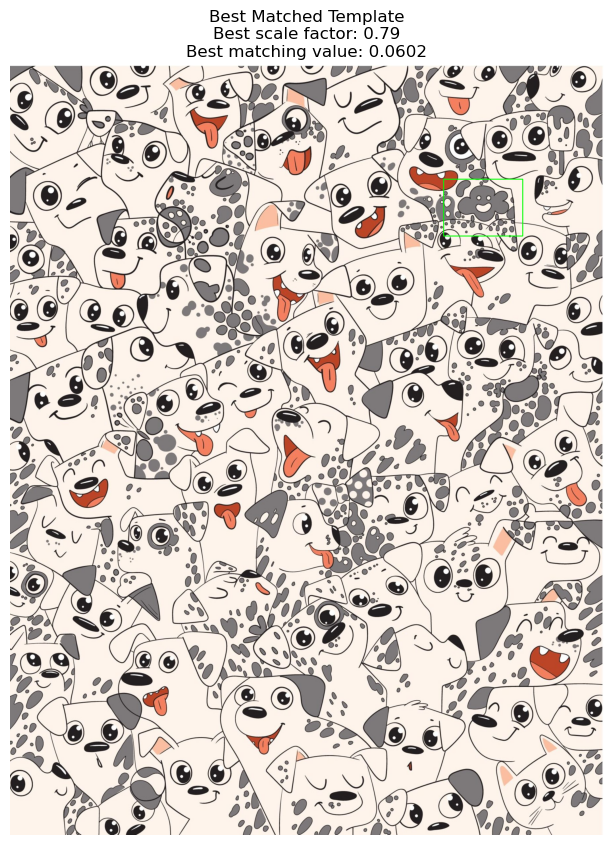

Processing: 2_objects\icecream.jpg


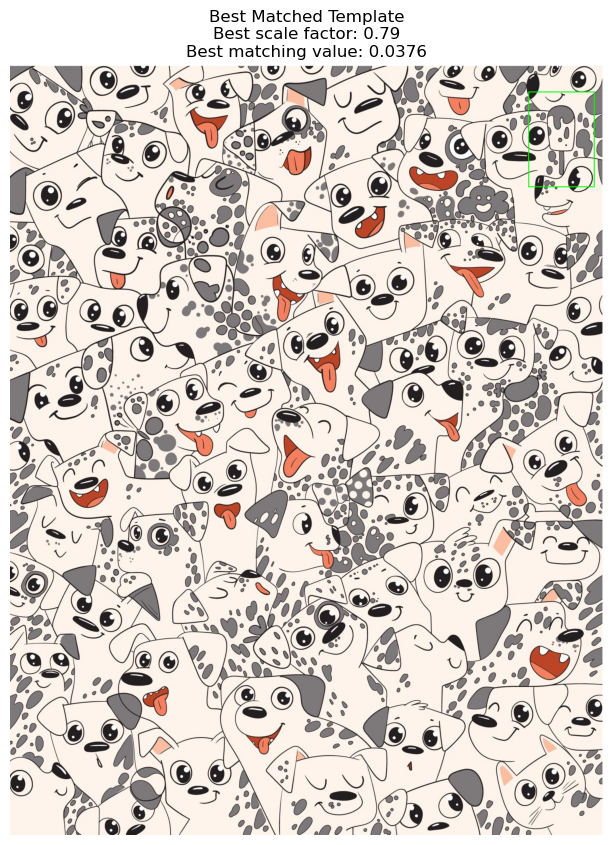

Processing: 2_objects\pizza.jpg


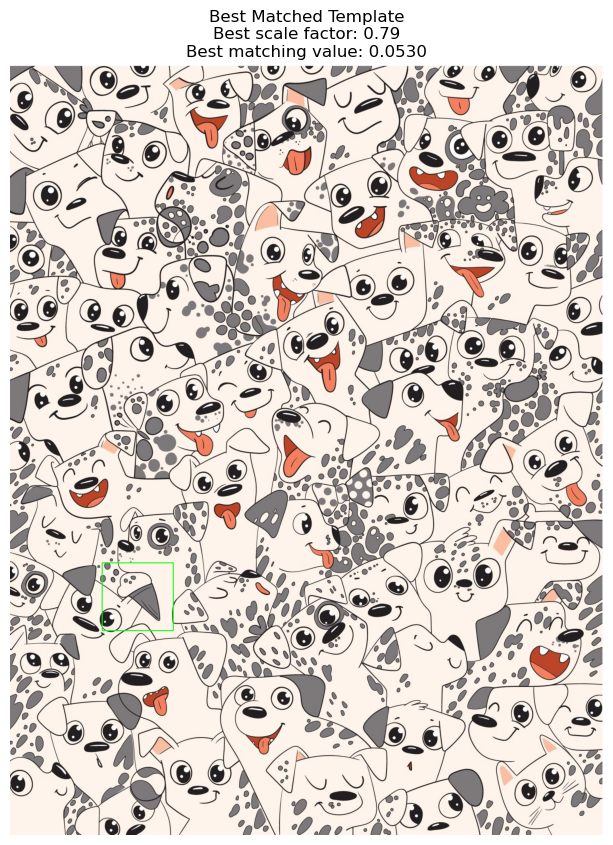

Processing: 2_objects\sausage.jpg


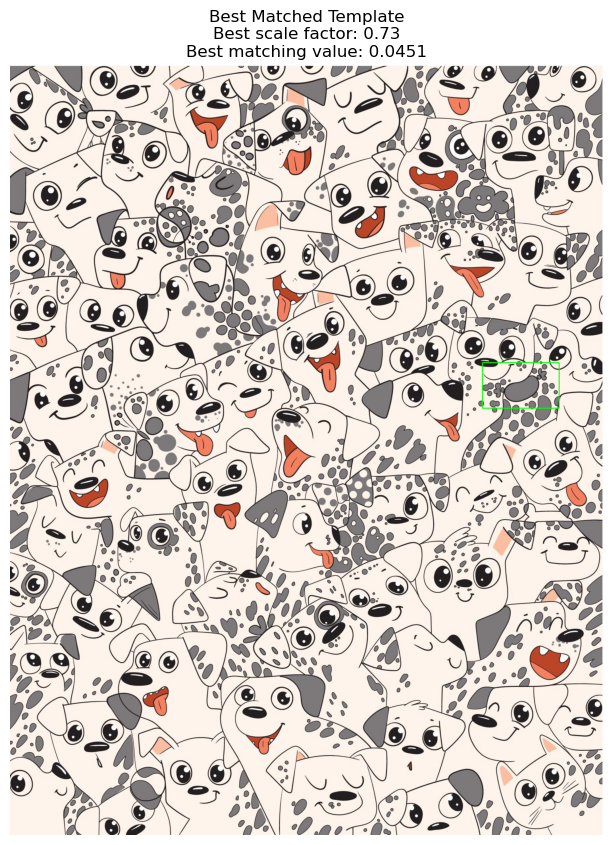

Processing: 2_objects\strawberry.jpg


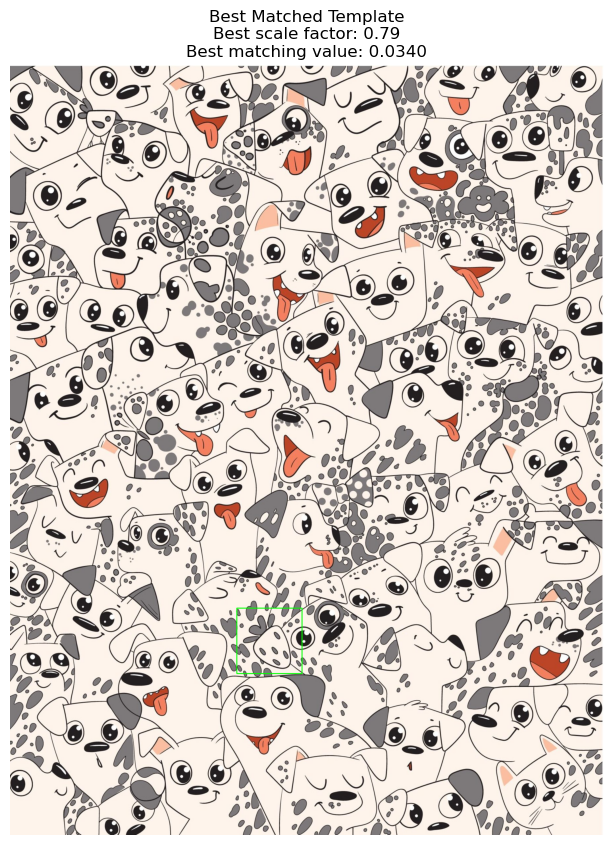

In [26]:

image=cv2.imread("2_cropped.jpg")
# Specify the folder path containing the images
folder_path = "2_objects"  # Replace with your folder path

# List all files in the folder
object_files = [f for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
# Loop through the image files
for object_file in object_files:
    # Get the full path of the image file
    template_path = os.path.join(folder_path, object_file)
    print("Processing:", template_path)
    # Read the image
    template = cv2.imread(template_path)
    
    find(image,template)
    

